# Stable Diffusion

In [1]:
!nvidia-smi

Fri Sep  1 01:33:13 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-SXM2...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   36C    P0    24W / 300W |      0MiB / 16384MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

## Installing the libraries



In [2]:
!pip install diffusers==0.11.1
!pip install -q accelerate transformers ftfy bitsandbytes==0.35.0 gradio natsort safetensors xformers

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 524.9/524.9 kB 8.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 12.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 251.2/251.2 kB 4.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.5/7.5 MB 27.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.1/53.1 kB 5.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.5/62.5 MB 30.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.1/20.1 MB 65.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 75.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 167.0/167.0 MB 5.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 118.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.2/66.2 kB 8.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 298.2/298.2 kB 33.8 MB/s eta 0:

## Pipeline for image generation



In [3]:
import torch #PyTorch
from diffusers import StableDiffusionPipeline

In [4]:
pipe = StableDiffusionPipeline.from_pretrained("CompVis/stable-diffusion-v1-4", torch_dtype=torch.float16)

safety_checker/pytorch_model.fp16.safetensors not found


Fetching 30 files:   0%|          | 0/30 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.
The config attributes {'scaling_factor': 0.18215} were passed to AutoencoderKL, but are not expected and will be ignored. Please verify your config.json configuration file.


In [5]:
pipe = pipe.to('cuda')

In [6]:
pipe.enable_attention_slicing()
pipe.enable_xformers_memory_efficient_attention()

### Creating the prompt

In [7]:
prompt = 'an apple'

### Generating the image



In [8]:
img = pipe(prompt).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

In [9]:
type(img)

PIL.Image.Image

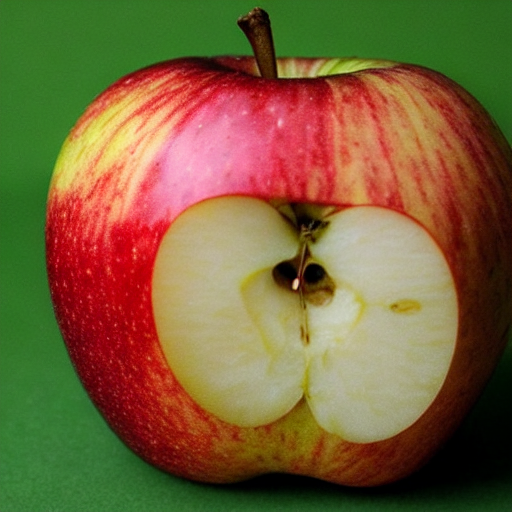

In [10]:
img

  0%|          | 0/50 [00:00<?, ?it/s]

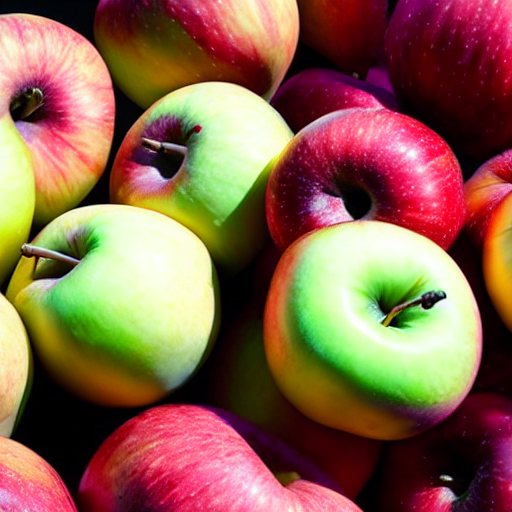

In [11]:
prompt = 'photograph of an apple'
img = pipe(prompt).images[0]
img

### Saving the result

In [12]:
img.save('result.png')

  0%|          | 0/50 [00:00<?, ?it/s]

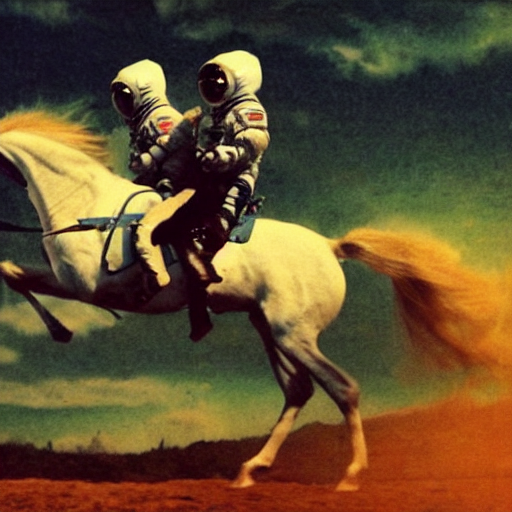

In [13]:
prompt = 'a photograph of an astronaut riding a horse, color'
img = pipe(prompt).images[0]
img

In [14]:
img.size

(512, 512)

## Generating multiple images

In [15]:
0.75 * 512

384.0

In [16]:
from PIL import Image

def grid_img(imgs, rows=1, cols=3, scale=1):
  assert len(imgs) == rows * cols

  w, h = imgs[0].size
  w, h = int(w * scale), int(h * scale)

  grid = Image.new('RGB', size = (cols * w, rows * h))
  grid_w, grid_h = grid.size

  for i, img in enumerate(imgs):
    img = img.resize((w, h), Image.ANTIALIAS)
    grid.paste(img, box=(i % cols * w, i // cols * h))
  return grid

  0%|          | 0/50 [00:00<?, ?it/s]

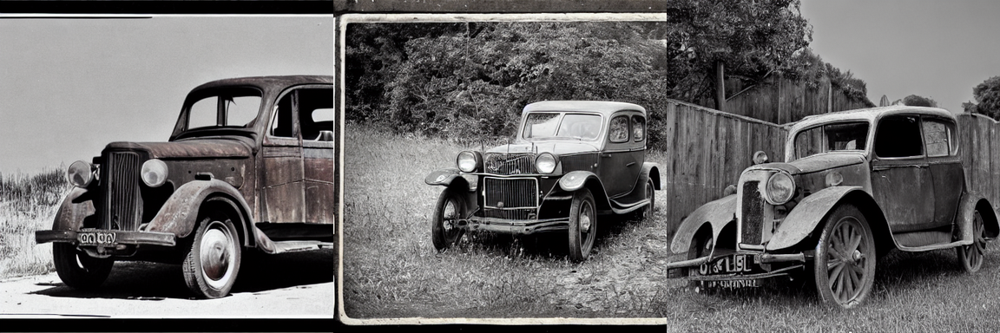

In [17]:
num_imgs = 3
prompt = 'photograph of an old car'
imgs = pipe(prompt, num_images_per_prompt=num_imgs).images
grid = grid_img(imgs, rows=1, cols=3, scale=0.75)
grid

## Parameters

### Seed




  0%|          | 0/50 [00:00<?, ?it/s]

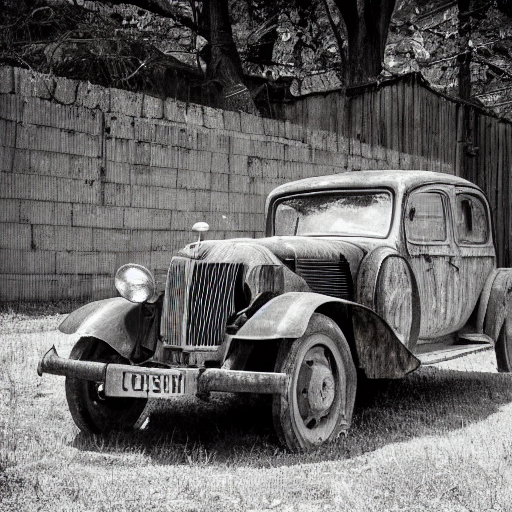

In [18]:
seed = 777
generator = torch.Generator('cuda').manual_seed(seed)
img = pipe(prompt, generator=generator).images[0]
img

  0%|          | 0/50 [00:00<?, ?it/s]

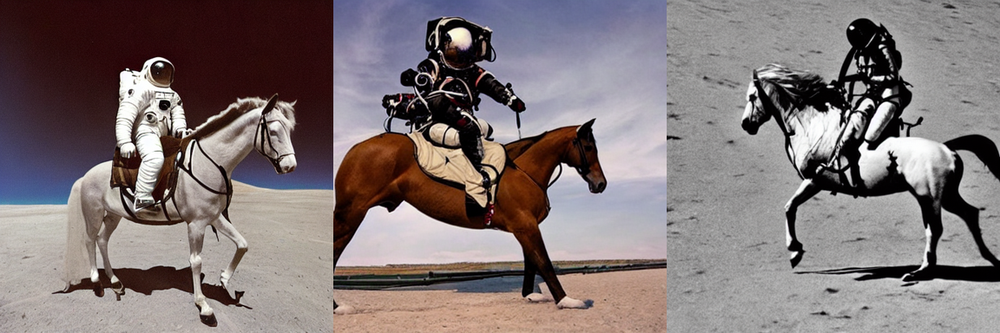

In [19]:
prompt = "a photograph of an astronaut riding a horse"
seed = 777
generator = torch.Generator("cuda").manual_seed(seed)
imgs = pipe(prompt, num_images_per_prompt=num_imgs, generator=generator).images
grid = grid_img(imgs, rows=1, cols=3, scale=0.75)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

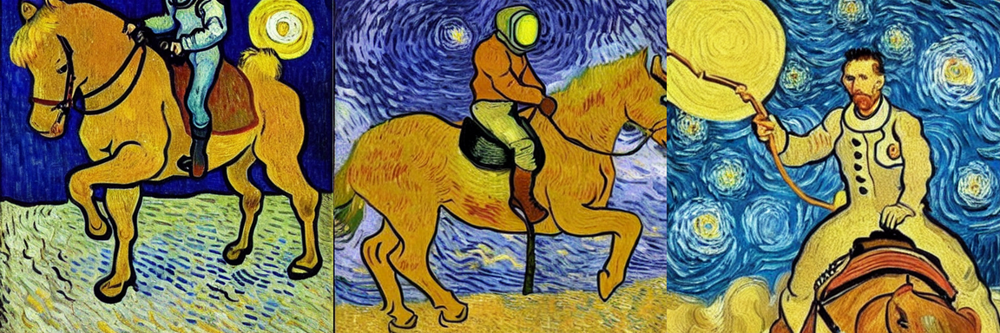

In [20]:
prompt = "van gogh painting of an astronaut riding a horse"
generator = torch.Generator("cuda").manual_seed(seed)
imgs = pipe(prompt, num_images_per_prompt=num_imgs, generator=generator).images
grid = grid_img(imgs, rows=1, cols=3, scale=0.75)
grid

### Inference steps

  0%|          | 0/20 [00:00<?, ?it/s]

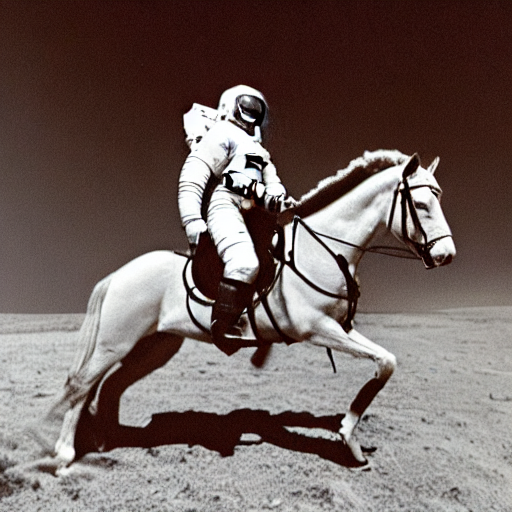

In [21]:
prompt = "a photograph of an astronaut riding a horse"
generator = torch.Generator("cuda").manual_seed(seed)
img = pipe(prompt, num_inference_steps=20, generator=generator).images[0]
img

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

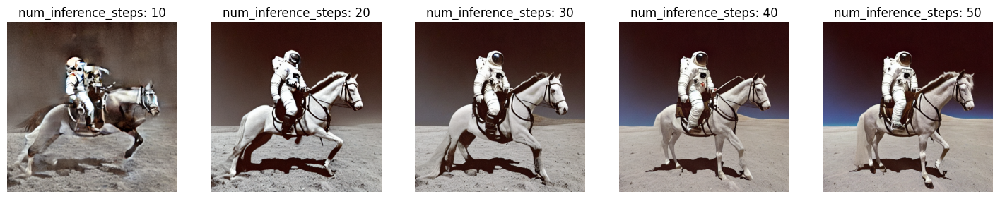

In [22]:
import matplotlib.pyplot as plt

plt.figure(figsize=(18,8))
for i in range(1, 6):
  n_steps = i * 10
  #print(n_steps)
  generator = torch.Generator('cuda').manual_seed(seed)
  img = pipe(prompt, num_inference_steps=n_steps, generator=generator).images[0]

  plt.subplot(1, 5, i)
  plt.title('num_inference_steps: {}'.format(n_steps))
  plt.imshow(img)
  plt.axis('off')
plt.show()

### Guidance scale (CFG)

  0%|          | 0/50 [00:00<?, ?it/s]

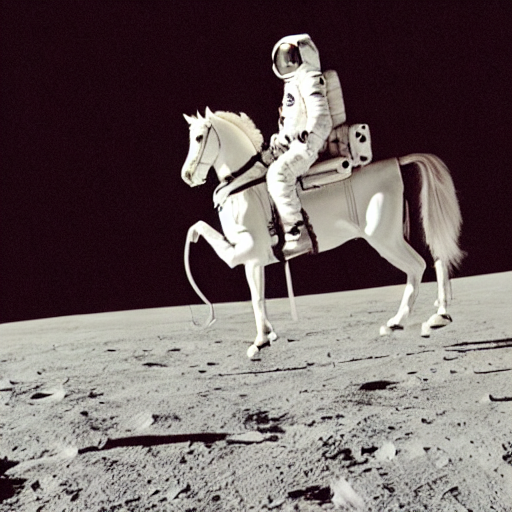

In [23]:
prompt = "a photograph of an astronaut riding a horse"

generator = torch.Generator("cuda").manual_seed(seed)
img = pipe(prompt, guidance_scale=10, generator=generator).images[0]
img

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

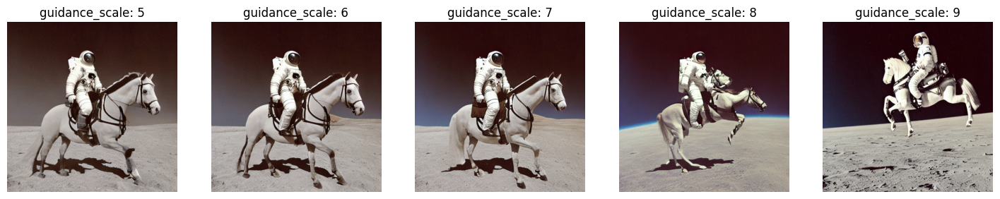

In [24]:
plt.figure(figsize=(18,8))
for i in range(1, 6):

  n_guidance = i + 4
  generator = torch.Generator("cuda").manual_seed(seed)
  img = pipe(prompt, guidance_scale=n_guidance, generator=generator).images[0]

  plt.subplot(1,5,i)
  plt.title('guidance_scale: {}'.format(n_guidance))
  plt.imshow(img)
  plt.axis('off')

plt.show()

### Image size (dimensions)


  0%|          | 0/50 [00:00<?, ?it/s]

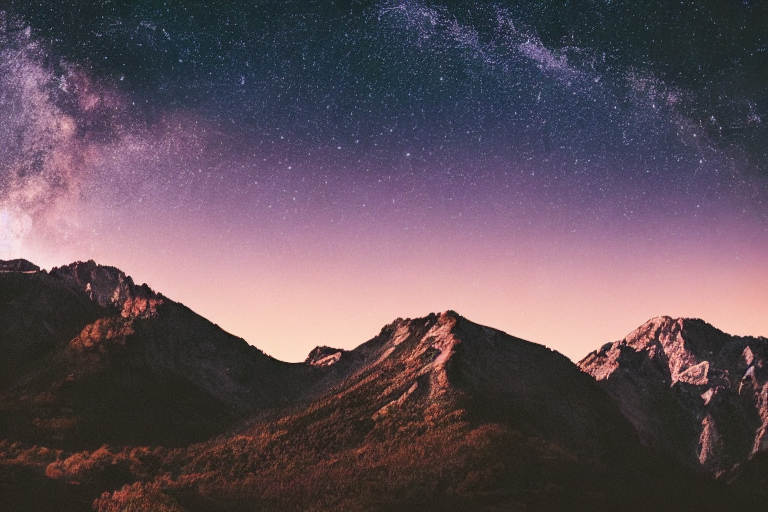

In [25]:
seed = 777
prompt = "photograph of a mountain landscape during sunset, stars in the sky"
generator = torch.Generator("cuda").manual_seed(seed)
h, w = 512, 768
img = pipe(prompt, height=h, width=w, generator=generator).images[0]
img

> Portrait mode



  0%|          | 0/50 [00:00<?, ?it/s]

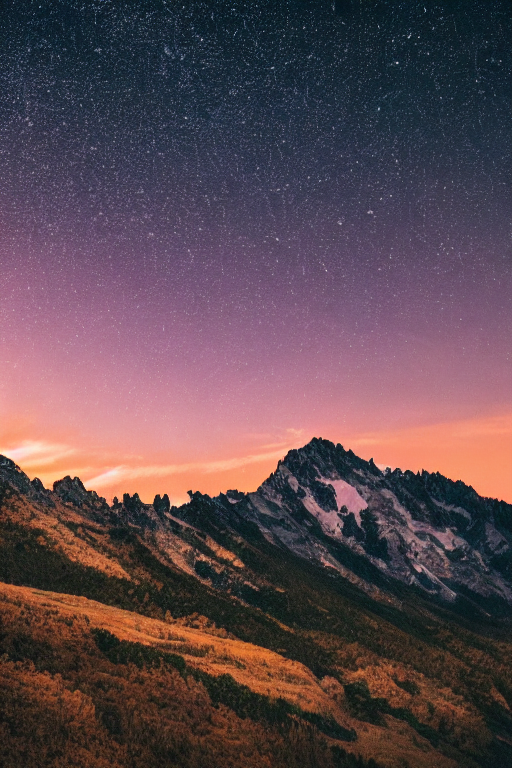

In [26]:
generator = torch.Generator("cuda").manual_seed(seed)
h, w = 768, 512
img = pipe(prompt, height=h, width=w, generator=generator).images[0]
img

### Negative prompt

  0%|          | 0/50 [00:00<?, ?it/s]

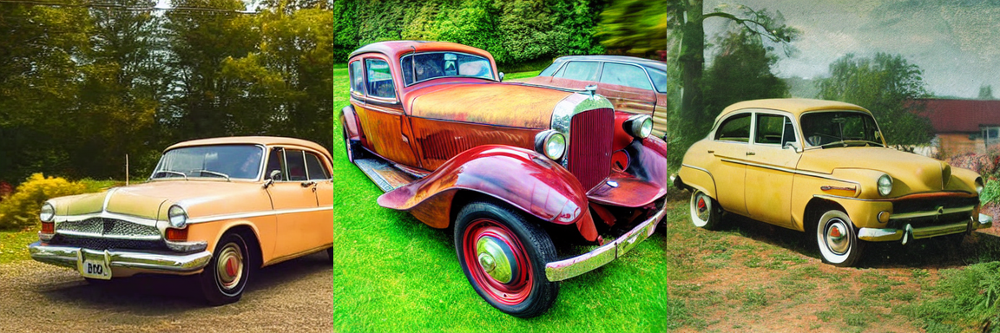

In [27]:
num_images = 3

prompt = 'photograph of an old car'
neg_prompt = 'bw photo'

imgs = pipe(prompt, negative_prompt = neg_prompt, num_images_per_prompt=num_images).images

grid = grid_img(imgs, rows = 1, cols = 3, scale=0.75)
grid

## Other models

### SD v1.5

In [28]:
sd15 = StableDiffusionPipeline.from_pretrained("runwayml/stable-diffusion-v1-5", torch_dtype=torch.float16)
sd15 = sd15.to('cuda')
sd15.enable_attention_slicing()
sd15.enable_xformers_memory_efficient_attention()

safety_checker/pytorch_model.fp16.safetensors not found


Fetching 29 files:   0%|          | 0/29 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

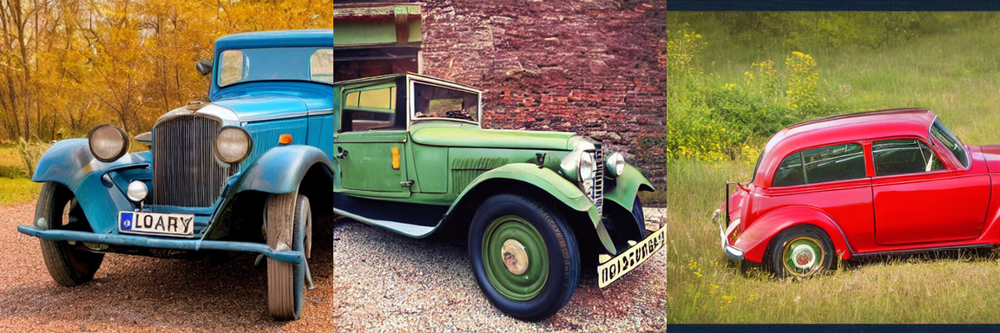

In [29]:
num_imgs = 3

prompt = "photograph of an old car"
neg_prompt = "bw photo"

imgs = sd15(prompt, negative_prompt=neg_prompt, num_images_per_prompt=num_imgs).images

grid = grid_img(imgs, rows=1, cols=3, scale=0.75)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

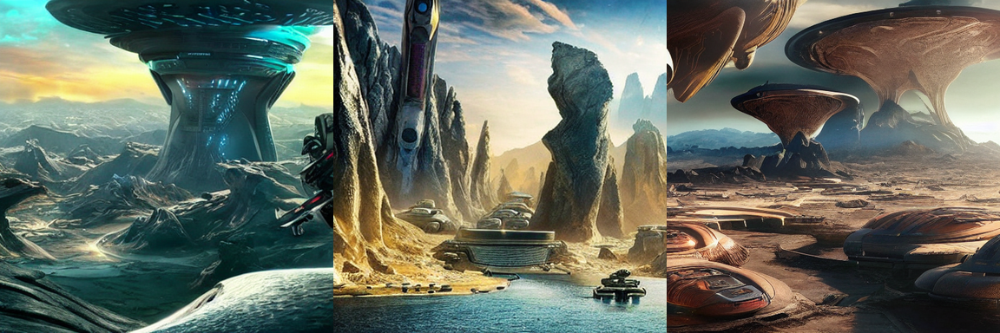

In [30]:
prompt = "photo of a futuristic city on another planet, realistic, full hd"
neg_prompt = 'buildings'

imgs = sd15(prompt, negative_prompt = neg_prompt, num_images_per_prompt=num_imgs).images

grid = grid_img(imgs, rows=1, cols=3, scale=0.75)
grid

### SD v2.x

In [31]:
sd2 = StableDiffusionPipeline.from_pretrained("stabilityai/stable-diffusion-2-1", torch_dtype=torch.float16)
sd2 = sd2.to("cuda")
sd2.enable_attention_slicing()
sd2.enable_xformers_memory_efficient_attention()

text_encoder/pytorch_model.fp16.safetensors not found


Fetching 22 files:   0%|          | 0/22 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

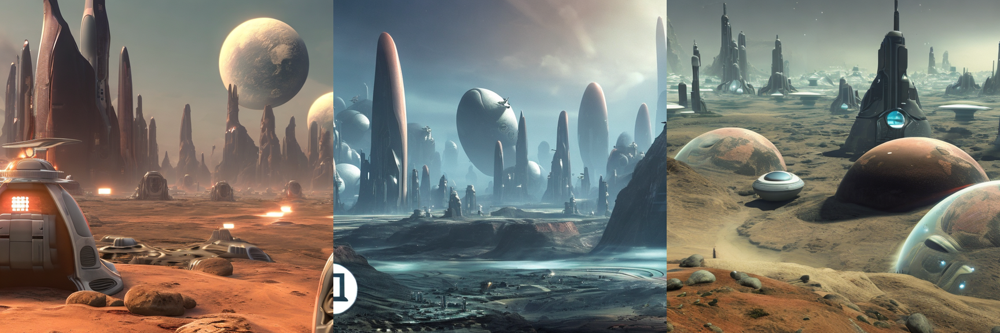

In [32]:
prompt = "photo of a futuristic city on another planet, realistic, full hd"
neg_prompt = 'buildings'

imgs = sd2(prompt, negative_prompt=neg_prompt, num_images_per_prompt=num_imgs).images

grid = grid_img(imgs, rows=1, cols=3, scale=0.75)
grid

### Fine-tuned models with specific styles


In [33]:
modi = StableDiffusionPipeline.from_pretrained("nitrosocke/mo-di-diffusion", torch_dtype=torch.float16)
modi = modi.to("cuda")
modi.enable_attention_slicing()
modi.enable_xformers_memory_efficient_attention()

Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.
The config attributes {'scaling_factor': 0.18215} were passed to AutoencoderKL, but are not expected and will be ignored. Please verify your config.json configuration file.


  0%|          | 0/50 [00:00<?, ?it/s]

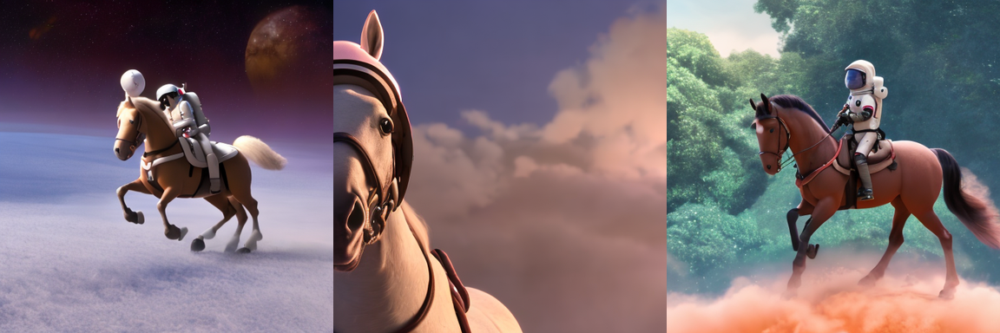

In [34]:
prompt = "a photograph of an astronaut riding a horse, modern disney style"

seed = 777
generator = torch.Generator("cuda").manual_seed(seed)

imgs = modi(prompt, generator=generator, num_images_per_prompt=num_imgs).images

grid = grid_img(imgs, rows=1, cols=3, scale=0.75)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

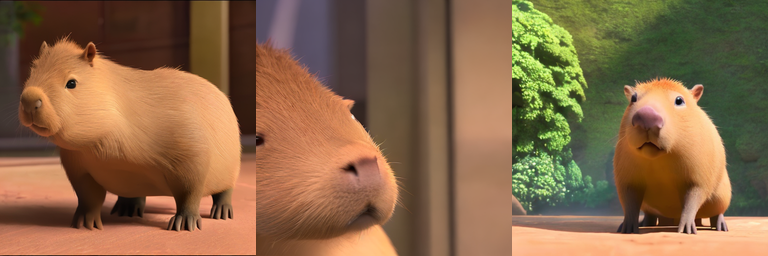

In [35]:
prompt = "capybara, modern disney style"

generator = torch.Generator("cuda").manual_seed(seed)
imgs = modi(prompt, generator=generator, num_images_per_prompt=3).images

grid = grid_img(imgs, rows=1, cols=3, scale=0.5)
grid

Seed: 


  0%|          | 0/50 [00:00<?, ?it/s]

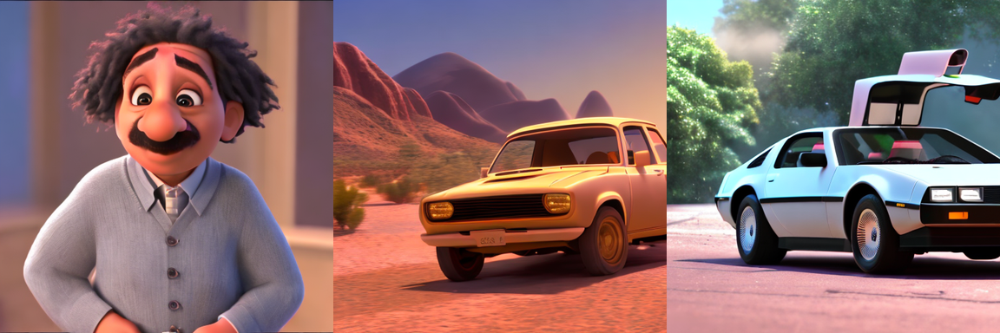

In [36]:
prompt = ["albert einstein, modern disney style",
          "modern disney style old chevette driving in the desert, golden hour",
          "modern disney style delorean"]

seed = 777
print("Seed: ".format(str(seed)))
generator = torch.Generator("cuda").manual_seed(seed)
imgs = modi(prompt, generator=generator).images

grid = grid_img(imgs, rows=1, cols=3, scale=0.75)
grid

#### Other models

## Changing the scheduler (sampler)


In [37]:
sd15 = StableDiffusionPipeline.from_pretrained("runwayml/stable-diffusion-v1-5", torch_dtype=torch.float16)
sd15 = sd15.to("cuda")
sd15.enable_attention_slicing()
sd15.enable_xformers_memory_efficient_attention()

safety_checker/pytorch_model.fp16.safetensors not found


Fetching 29 files:   0%|          | 0/29 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


In [38]:
sd15.scheduler

PNDMScheduler {
  "_class_name": "PNDMScheduler",
  "_diffusers_version": "0.11.1",
  "beta_end": 0.012,
  "beta_schedule": "scaled_linear",
  "beta_start": 0.00085,
  "clip_sample": false,
  "num_train_timesteps": 1000,
  "prediction_type": "epsilon",
  "set_alpha_to_one": false,
  "skip_prk_steps": true,
  "steps_offset": 1,
  "trained_betas": null
}

  0%|          | 0/50 [00:00<?, ?it/s]

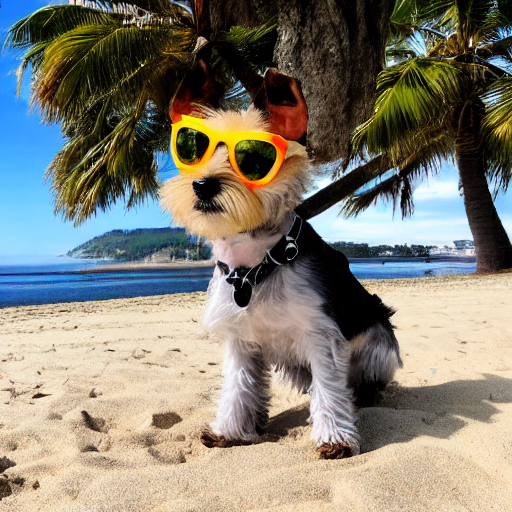

In [39]:
seed = 777
prompt = "a photo of a terrier wearing sunglasses, on the beach, ocean in the background"
generator = torch.Generator('cuda').manual_seed(seed)
img = sd15(prompt, generator=generator).images[0]
img

In [40]:
sd15.scheduler.compatibles

[diffusers.schedulers.scheduling_ddpm.DDPMScheduler,
 diffusers.schedulers.scheduling_dpmsolver_multistep.DPMSolverMultistepScheduler,
 diffusers.schedulers.scheduling_euler_ancestral_discrete.EulerAncestralDiscreteScheduler,
 diffusers.schedulers.scheduling_heun_discrete.HeunDiscreteScheduler,
 diffusers.schedulers.scheduling_dpmsolver_singlestep.DPMSolverSinglestepScheduler,
 diffusers.schedulers.scheduling_pndm.PNDMScheduler,
 diffusers.schedulers.scheduling_ddim.DDIMScheduler,
 diffusers.schedulers.scheduling_euler_discrete.EulerDiscreteScheduler,
 diffusers.schedulers.scheduling_lms_discrete.LMSDiscreteScheduler]

In [41]:
sd15.scheduler.config

FrozenDict([('num_train_timesteps', 1000),
            ('beta_start', 0.00085),
            ('beta_end', 0.012),
            ('beta_schedule', 'scaled_linear'),
            ('trained_betas', None),
            ('skip_prk_steps', True),
            ('set_alpha_to_one', False),
            ('prediction_type', 'epsilon'),
            ('steps_offset', 1),
            ('_class_name', 'PNDMScheduler'),
            ('_diffusers_version', '0.11.1'),
            ('clip_sample', False)])

In [42]:
from diffusers import DDIMScheduler
sd15.scheduler = DDIMScheduler.from_config(sd15.scheduler.config)

  0%|          | 0/50 [00:00<?, ?it/s]

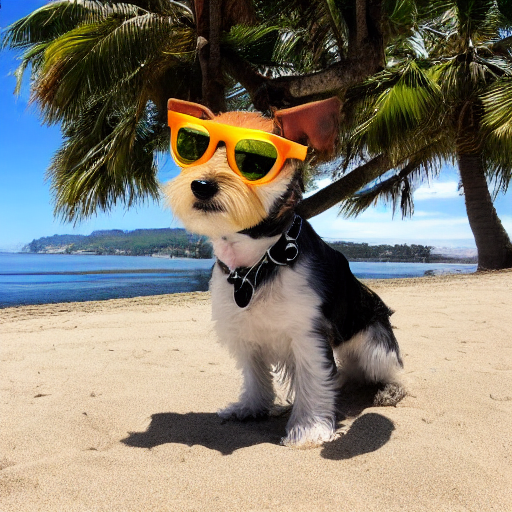

In [43]:
generator = torch.Generator(device = 'cuda').manual_seed(seed)
img = sd15(prompt, generator=generator).images[0]
img

  0%|          | 0/60 [00:00<?, ?it/s]

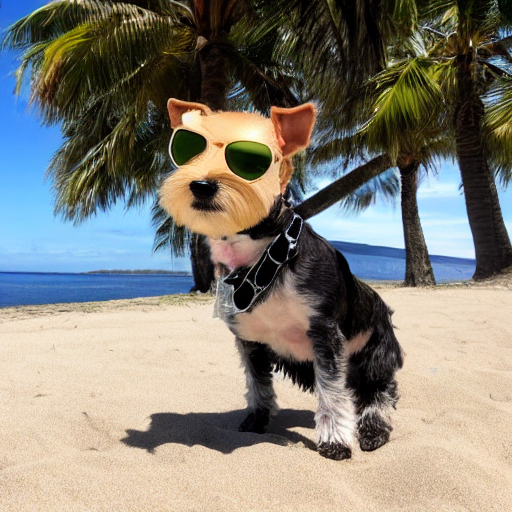

In [44]:
from diffusers import LMSDiscreteScheduler
sd15.scheduler = LMSDiscreteScheduler.from_config(sd15.scheduler.config)
generator = torch.Generator(device = 'cuda').manual_seed(seed)
img = sd15(prompt, num_inference_steps = 60, generator=generator).images[0]
img

  0%|          | 0/50 [00:00<?, ?it/s]

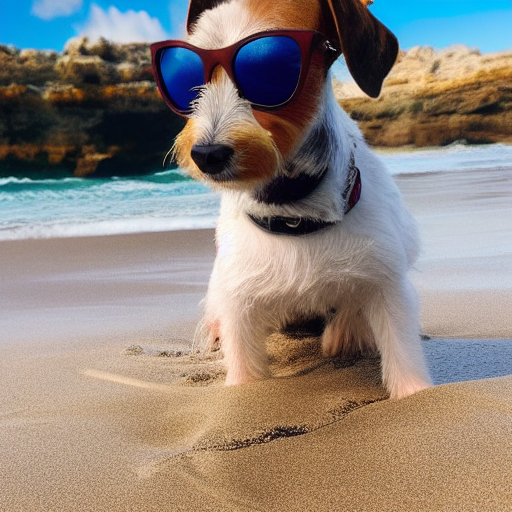

In [45]:
from diffusers import EulerAncestralDiscreteScheduler

sd15.scheduler = EulerAncestralDiscreteScheduler.from_config(pipe.scheduler.config)

generator = torch.Generator(device="cuda").manual_seed(seed)
img = sd15(prompt, generator=generator, num_inference_steps=50).images[0]
img

  0%|          | 0/50 [00:00<?, ?it/s]

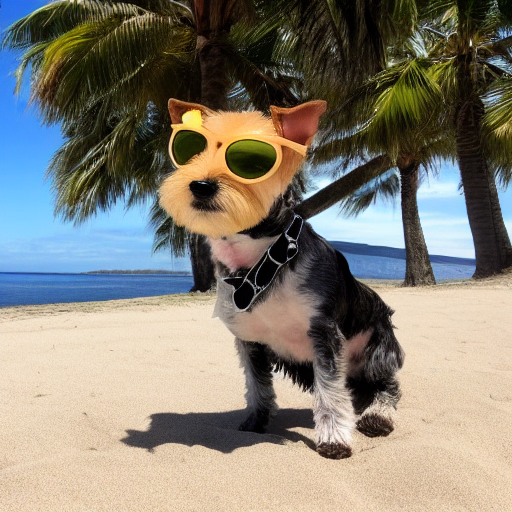

In [46]:
from diffusers import EulerDiscreteScheduler

sd15.scheduler = EulerDiscreteScheduler.from_config(pipe.scheduler.config)

generator = torch.Generator(device="cuda").manual_seed(seed)
img = sd15(prompt, generator=generator, num_inference_steps=50).images[0]
img